### submission.csv 파일 시각화

In [1]:
import pandas as pd; pd.options.mode.chained_assignment = None
import numpy as np

# Built In Imports

from datetime import datetime
from glob import glob
import warnings
import IPython
import urllib
import zipfile
import pickle
import shutil
import string
import math
import tqdm
import time
import os
import gc
import re

# Visualization Imports

from matplotlib.colors import ListedColormap
import matplotlib.patches as patches
import plotly.graph_objects as go
import matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns
from PIL import Image
import matplotlib
import plotly
import PIL
import cv2

from pycocotools.coco import COCO

# Other Imports

from tqdm.notebook import tqdm
from PIL import Image, ImageDraw,ImageFont

LABELCOLORS = [px.colors.label_rgb(px.colors.convert_to_RGB_255(x)) for x in sns.color_palette("Spectral", 10)]
LABELCOLORSWOUTNOFINDING = LABELCOLORS[:8]+LABELCOLORS[9:]

import os
os.environ["KMP_DUPLICATE_LIB_OK"]="TRUE"

In [2]:
# 제출할 submission file 경로 입력
submission_file = 'baseline/detectron2/output/Cascade_rcnn/submission_det2_casecade_kfold.csv'
test_df = pd.read_csv(submission_file)
data_path = '../dataset/'

In [ ]:
colors = ['red', 'green', 'blue', 'yellow', 'magenta', 'cyan', 'orange', 'chartreuse', 'purple', 'azure']
classes = ["General trash", "Paper", "Paper pack", "Metal", "Glass", 
           "Plastic", "Styrofoam", "Plastic bag", "Battery", "Clothing"]

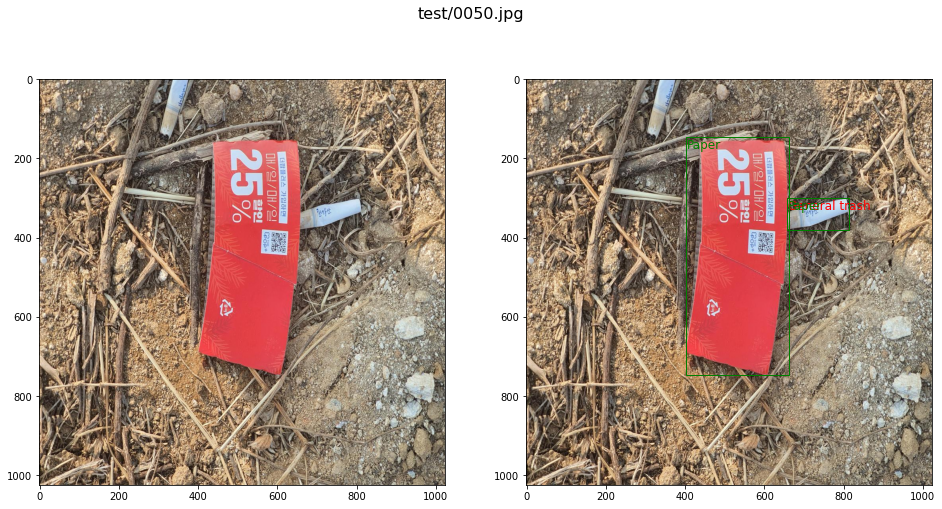

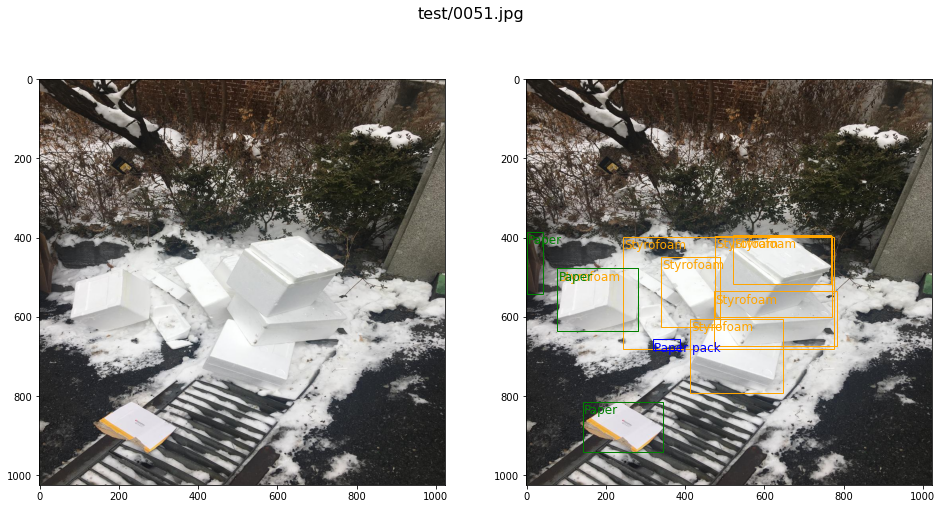

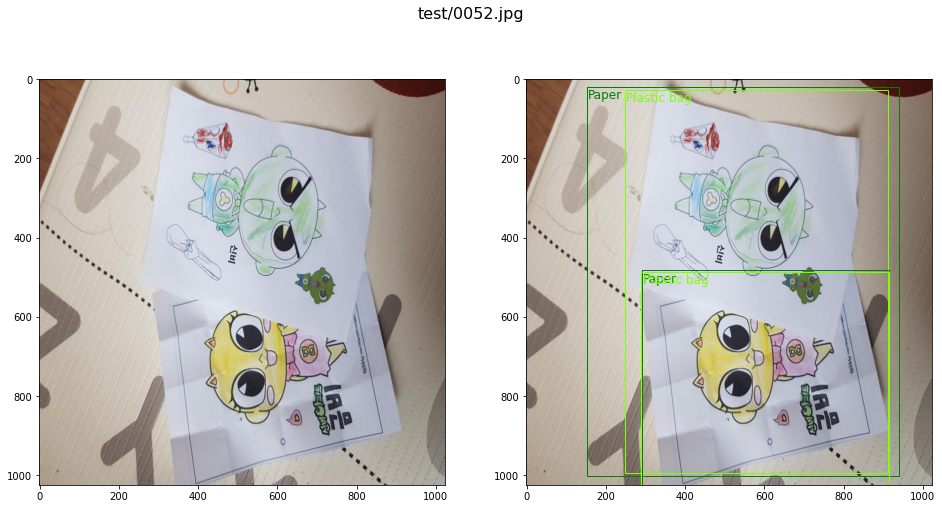

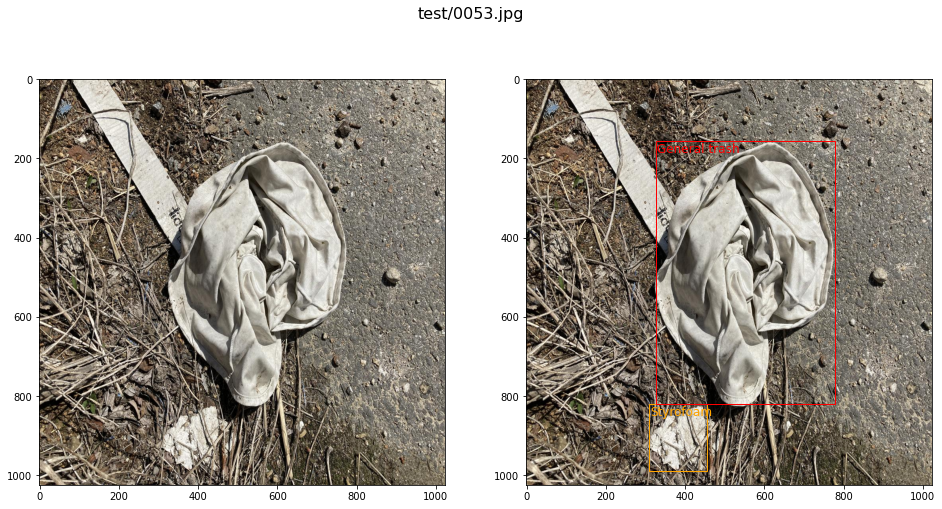

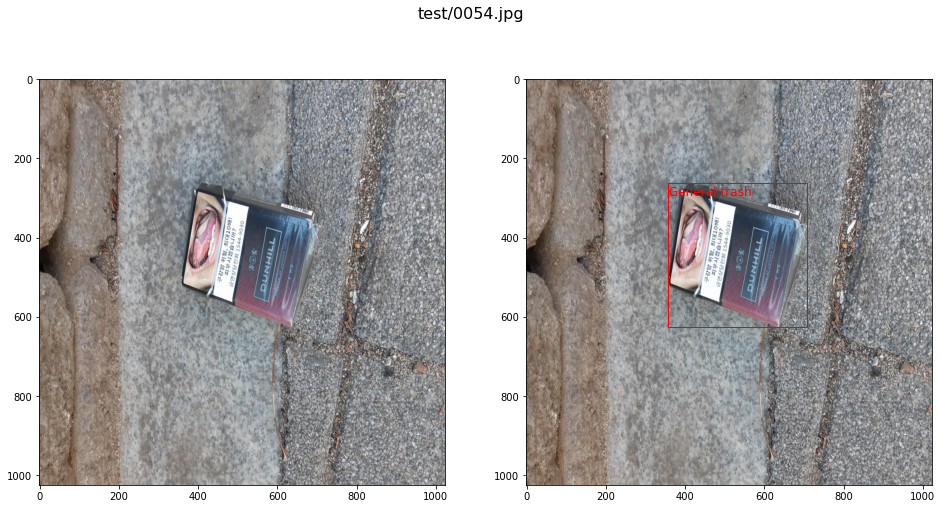

...

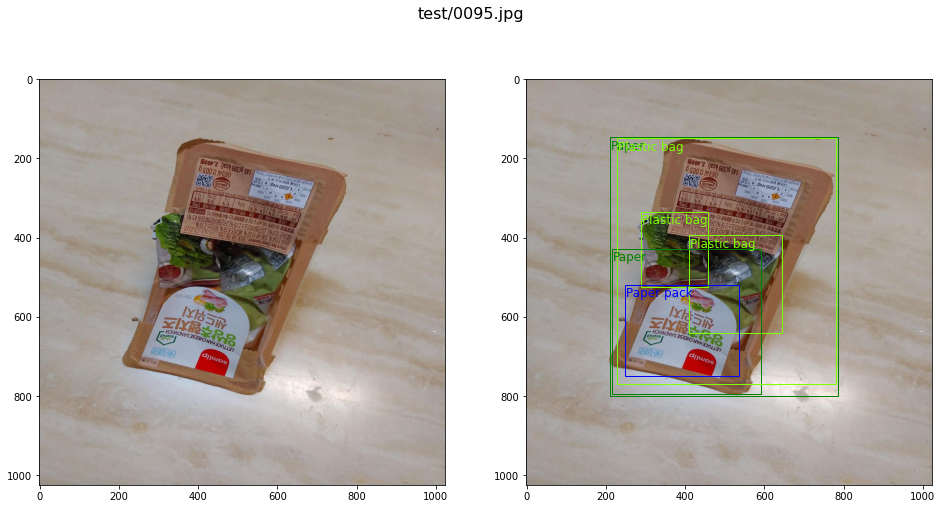

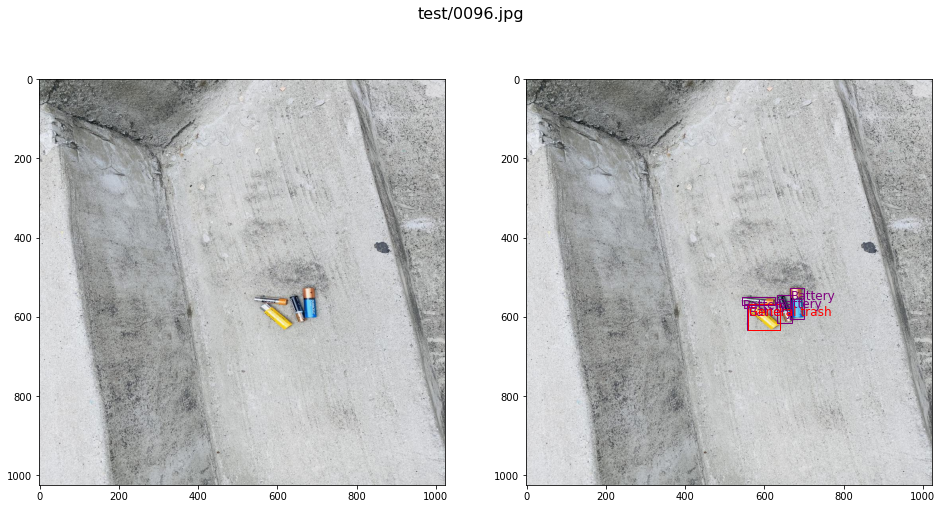

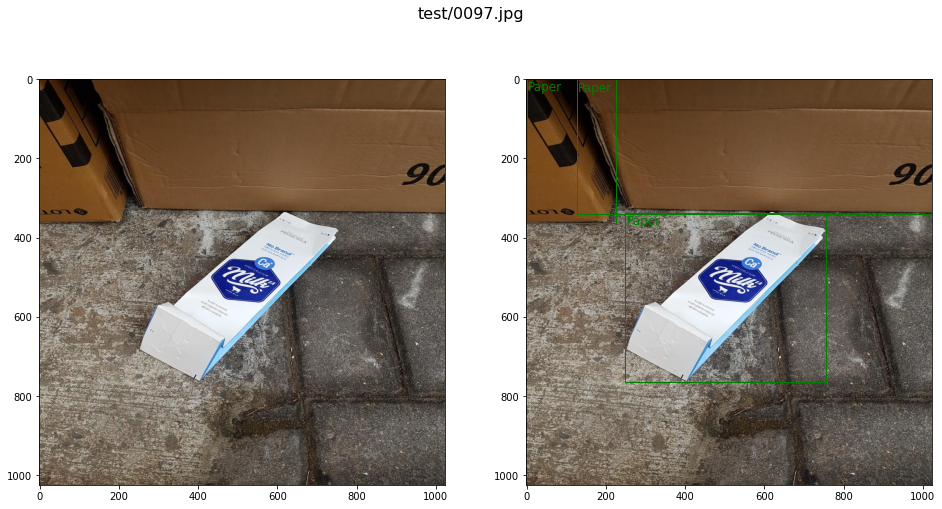

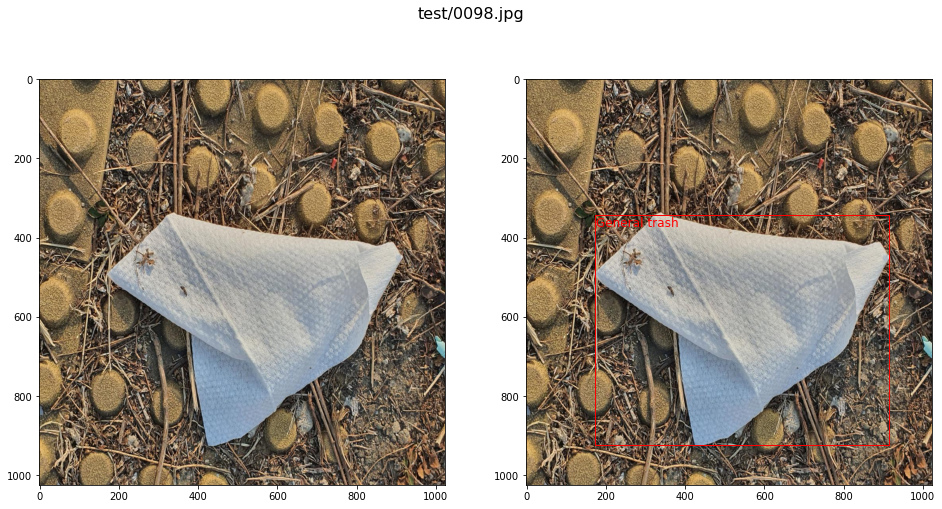

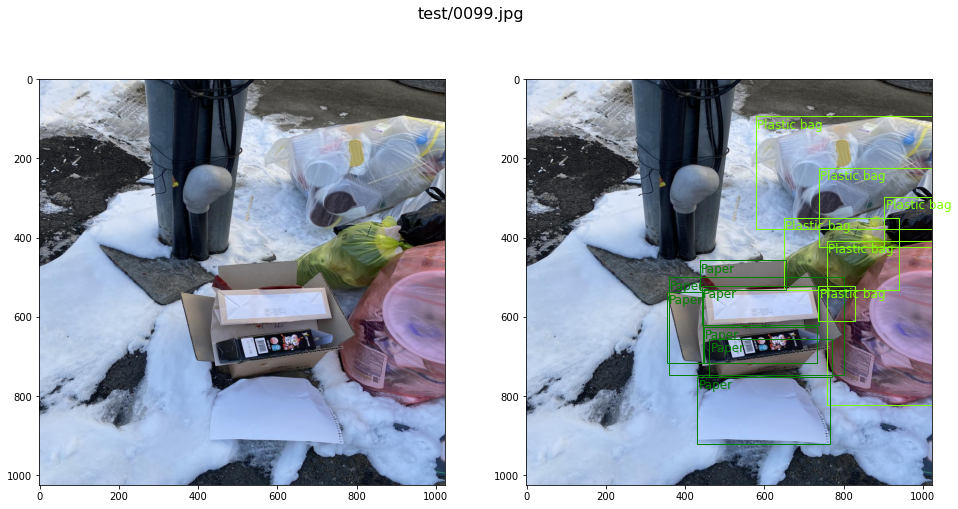

In [3]:
# image index 설정 

for idx in test_df.index[50:100]:
    anns = test_df['PredictionString'][idx].split(' ')
    filename = test_df['image_id'][idx]
    
    image = Image.open(os.path.join(data_path, filename))
    
    fig,(ax1, ax2) = plt.subplots(1,2,figsize=(16,8))
    plt.suptitle(f'{filename}', fontsize = 16)
    ax1.imshow(image)
    
    for i in range(len(anns)//6):
        draw = ImageDraw.Draw(image)
        ann = anns[i*6:i*6+6]
        category = int(ann[0])
        score = ann[1]
        try:
            ax2.add_patch(patches.Rectangle((float(ann[2]), float(ann[3])), float(ann[4])-float(ann[2]), float(ann[5])-float(ann[3]), edgecolor = colors[int(category)],fill=False))
            plt.text(float(ann[2])+3,float(ann[3])+30,classes[category], color = colors[category],size=12)
        except:
            continue
        
    ax2.imshow(image)
    plt.show()